In [1]:
import sys
import torch
import tensorflow as tf
from retinaface import RetinaFace
import matplotlib.pyplot as plt
import xml.etree.ElementTree as ET
import numpy as np
import cv2
import face_detection
import time

In [2]:
print(sys.version)
print(np.__version__)
print(tf.__version__)
print(torch.__version__)
print(cv2.__version__)

3.10.14 | packaged by Anaconda, Inc. | (main, May  6 2024, 19:44:50) [MSC v.1916 64 bit (AMD64)]
1.26.4
2.10.1
2.4.0
4.10.0


In [13]:
def getimagewithlabels(xml_file:str , targetname:str)->list:
    #xml_file = '../minidataset/labels.xml'
    #parsear el archivo XML
    tree = ET.parse(xml_file)
    root = tree.getroot()
    image = root.find(f".//image[@name='{targetname}']")
    if image is not None:
        img = cv2.imread(f"../minidataset/{targetname}")

        points = image.findall('points')
        total_faces = len(points)
        
        #iterar sobre los puntos en la imagen
        for point in image.findall('points'):
            coords = point.get('points').split(',')
            
            x, y = int(float(coords[0])), int(float(coords[1]))
            cv2.circle(img, (x, y), radius=5, color=(0, 0, 0), thickness=-1)  # Borde negro
            cv2.circle(img, (x, y), radius=4, color=(208, 230, 53), thickness=-1)  # Relleno amarillo
        
        img_rgb_labels = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        return [img_rgb_labels,total_faces]
        
    else:
        return None

def getimagefacesretina(imgpath:str)->list:
    image = cv2.imread(imgpath)
    t = time.time()
    faces = RetinaFace.detect_faces(imgpath)
    total_time = time.time()-t
    total_faces = len(faces.keys())
    for key in faces.keys():
        face = faces[key]
        facialarea = face["facial_area"]
        cv2.rectangle(image, (facialarea[2],facialarea[3]), (facialarea[0],facialarea[1]), (190, 227, 104), 2)
    
    img_rgb_with_boxes_retina = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    return [img_rgb_with_boxes_retina, total_faces, total_time]

def getimagefacesdsfd(imgpath:str)->list:

    image = cv2.imread(imgpath)
    img_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convertir BGR a RGB para matplotlib

    #construir el detector DSFD
    detector = face_detection.build_detector(
        name="DSFDDetector",
        confidence_threshold= 0.35,
        nms_iou_threshold = 0.3,
        max_resolution = None,
        fp16_inference = False,
        clip_boxes = False
    )

    #detectar los rostros en la imagen
    t = time.time()
    dets = detector.detect(image[:, :, ::-1])[:, :4]  # Detección
    total_time = time.time()-t
    total_faces = len(dets)

    #dibujar las caras detectadas
    for bbox in dets:
        x0, y0, x1, y1 = [int(_) for _ in bbox]
        cv2.rectangle(image, (x0, y0), (x1, y1), (0, 255, 0), 2)

    #convertir la imagen con las cajas delimitadoras a RGB para mostrarla con matplotlib
    img_rgb_with_boxes_dsfd = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    return [img_rgb_with_boxes_dsfd, total_faces, total_time]


1. Faces labels: 55
2. Faces labels: 68
3. Faces labels: 44


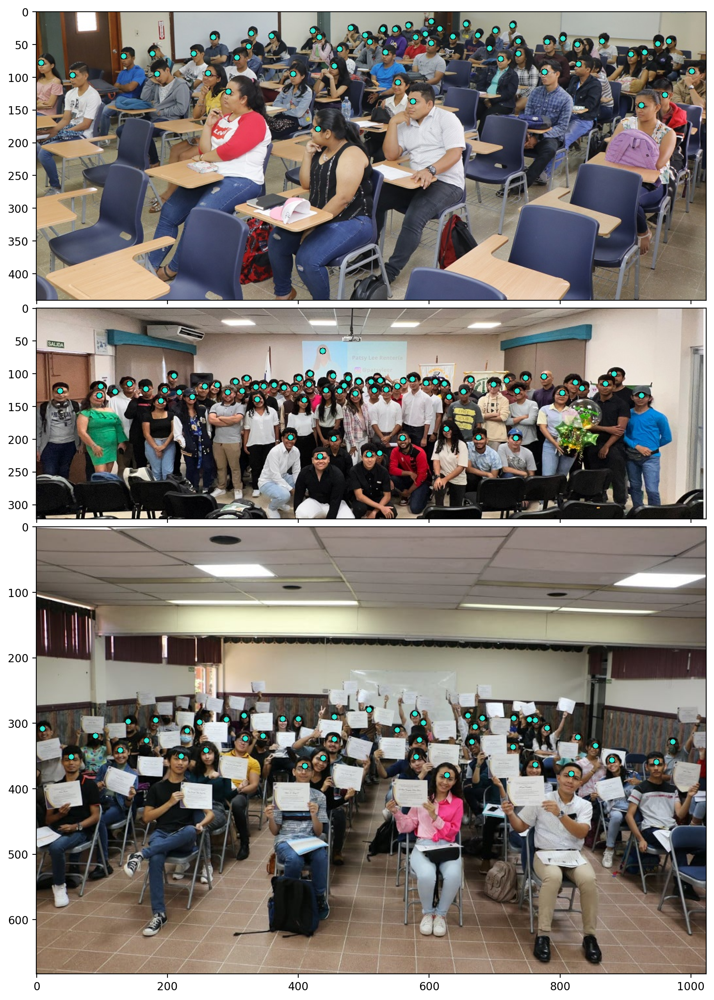

In [5]:
from mpl_toolkits.axes_grid1 import ImageGrid

# Lista de nombres específicos de las imágenes que quieres encontrar
list_target_image_name = ["image020.jpg", "image023.jpg", "image059.jpg", ]

# Lista para almacenar las imágenes procesadas
images_rgb_list = []

img_rgb_label1 = getimagewithlabels('../minidataset/labels.xml','image020.jpg')
print(f"1. Faces labels: {img_rgb_label1[1]}")

img_rgb_label2 = getimagewithlabels('../minidataset/labels.xml','image023.jpg')
print(f"2. Faces labels: {img_rgb_label2[1]}")

img_rgb_label3 = getimagewithlabels('../minidataset/labels.xml','image059.jpg')
print(f"3. Faces labels: {img_rgb_label3[1]}")

images_rgb_list.append(img_rgb_label1[0])
images_rgb_list.append(img_rgb_label2[0])
images_rgb_list.append(img_rgb_label3[0])

# Crear el grid de imágenes
fig = plt.figure(figsize=(16, 16), dpi=200)
grid = ImageGrid(fig, 111,  #similar to subplot(111)
                 nrows_ncols=(3,1),  # crea un grid de 3x3
                 axes_pad=0.1,  # espacio entre las imágenes en pulgadas
                 )

# Mostrar las imágenes en el grid
for ax, im in zip(grid, images_rgb_list):
    ax.imshow(im)
    #ax.tick_params(top=True, bottom=True, left=True, right=True, labeltop=False, labelbottom=True)
    #ax.xaxis.set_ticks_position('both')
    #ax.yaxis.set_ticks_position('both')
    ax.axis('on')
    
plt.savefig("grid_ref_labels.png", bbox_inches='tight', pad_inches=0.1)
#plt.show()

1. Retina Faces detected: 55 | Execution time: 0.664s
2. Retina Faces detected: 68 | Execution time: 0.391s
3. Retina Faces detected: 44 | Execution time: 0.393s


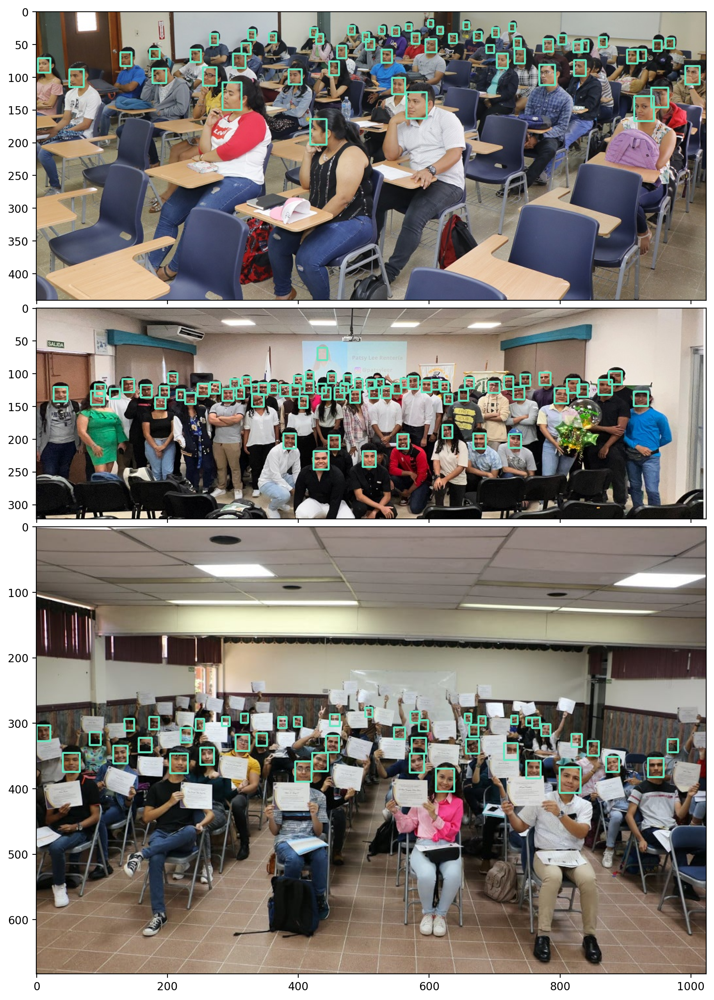

In [11]:
img_rgb_boxes_retina1 = getimagefacesretina('../minidataset/image020.jpg')
print(f"1. Retina Faces detected: {img_rgb_boxes_retina1[1]} | Execution time: {img_rgb_boxes_retina1[2]:.3f}s")

img_rgb_boxes_retina2 = getimagefacesretina('../minidataset/image023.jpg')
print(f"2. Retina Faces detected: {img_rgb_boxes_retina2[1]} | Execution time: {img_rgb_boxes_retina2[2]:.3f}s")

img_rgb_boxes_retina3 = getimagefacesretina('../minidataset/image059.jpg')
print(f"3. Retina Faces detected: {img_rgb_boxes_retina3[1]} | Execution time: {img_rgb_boxes_retina3[2]:.3f}s")

images_rgb_list = []
images_rgb_list.append(img_rgb_boxes_retina1[0])
images_rgb_list.append(img_rgb_boxes_retina2[0])
images_rgb_list.append(img_rgb_boxes_retina3[0])

# Crear el grid de imágenes
fig = plt.figure(figsize=(16, 16), dpi=200)
grid = ImageGrid(fig, 111,  
                 nrows_ncols=(3,1), 
                 axes_pad=0.1,
                 )

# Mostrar las imágenes en el grid
for ax, im in zip(grid, images_rgb_list):
    ax.imshow(im)
    ax.axis('on')
    
plt.savefig("grid_faces_retinaface.png", bbox_inches='tight', pad_inches=0.1)
plt.show()


1. DSFD Faces detected: 52 | Execution time: 4.529s
2. DSFD Faces detected: 65 | Execution time: 3.816s
3. DSFD Faces detected: 44 | Execution time: 7.105s


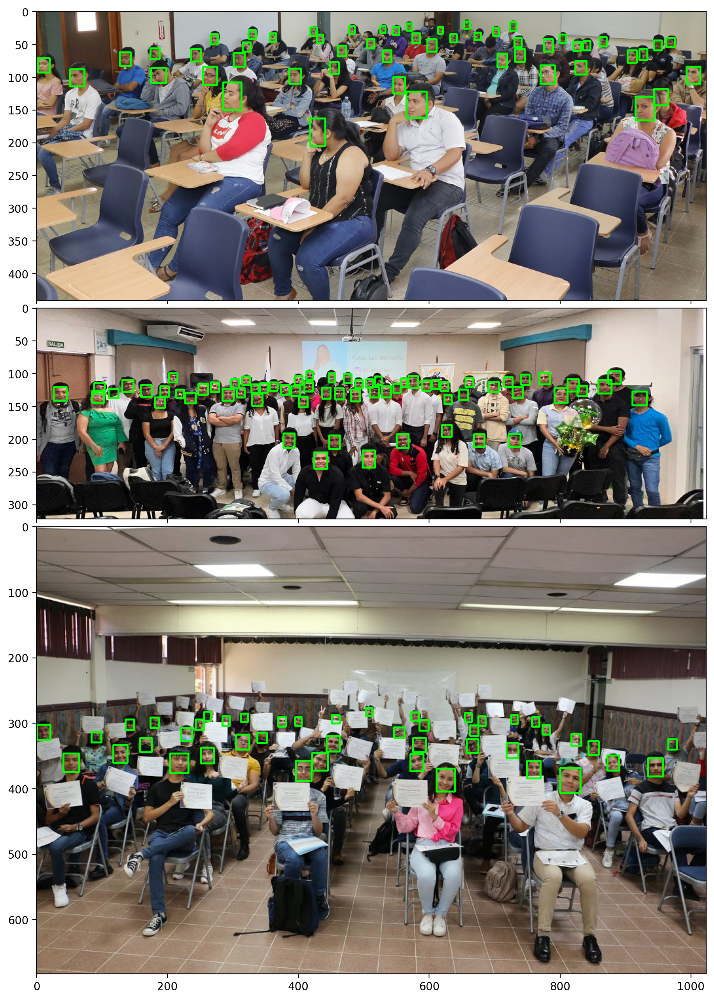

In [12]:
img_rgb_boxes_dsfd1 = getimagefacesdsfd('../minidataset/image020.jpg')
print(f"1. DSFD Faces detected: {img_rgb_boxes_dsfd1[1]} | Execution time: {img_rgb_boxes_dsfd1[2]:.3f}s")

img_rgb_boxes_dsfd2 = getimagefacesdsfd('../minidataset/image023.jpg')
print(f"2. DSFD Faces detected: {img_rgb_boxes_dsfd2[1]} | Execution time: {img_rgb_boxes_dsfd2[2]:.3f}s")

img_rgb_boxes_dsfd3 = getimagefacesdsfd('../minidataset/image059.jpg')
print(f"3. DSFD Faces detected: {img_rgb_boxes_dsfd3[1]} | Execution time: {img_rgb_boxes_dsfd3[2]:.3f}s")

images_rgb_list = []
images_rgb_list.append(img_rgb_boxes_dsfd1[0])
images_rgb_list.append(img_rgb_boxes_dsfd2[0])
images_rgb_list.append(img_rgb_boxes_dsfd3[0])

# Crear el grid de imágenes
fig = plt.figure(figsize=(16, 16), dpi=200)
grid = ImageGrid(fig, 111,  
                 nrows_ncols=(3,1), 
                 axes_pad=0.1,
                 )

# Mostrar las imágenes en el grid
for ax, im in zip(grid, images_rgb_list):
    ax.imshow(im)
    ax.axis('on')
    
plt.savefig("grid_faces_dsfd.png", bbox_inches='tight', pad_inches=0.1)
plt.show()